# Affective signals III
----
<span style="color:Blue">**Through this notebook we hope you get an hands on approach to the seminar. 
    Below you will find code snippets and theory that will help you apply the various libraries that have been introduced to you in the course.**</span>

----

In [12]:
import opensmile
import audiofile
import matplotlib.pyplot as plt
import pandas as pd
import subprocess
from scipy.io.wavfile import read
import numpy as np 
from IPython.display import Image, Video, Audio
from parselmouth.praat import call
import ipywidgets as widgets
import glob

import seaborn as sns
#parselmouth
import parselmouth
sns.set()

## Voice
----
Speech as we know is a primary mode of communication.We will be using parselmouth to create some visualizations and OpenSmile to extract the relevant features.

----
First lets try to extract your audio from the mp4 files 

In [2]:
def extract_wav(input_file,name_outfile):
    """
    Takes your video file and extracts the audio file
    
    inputfile : path to your video that you want to extract the audio features
    name_outfile: Name of the output audio file 
    """
    result = subprocess.run(['ffmpeg', '-i', input_file, '-vn', '-acodec', 'pcm_s16le', '-ar', '16000', '-bits_per_raw_sample', '16', '-ac', '1', './' + name_outfile + '_mono.wav', '-y'])

#path to your video ( remember it is the path from within the docker container)
#Below is an example of my path from within the docker container
extract_wav("Self_Intro.mp4","output")

ffmpeg version 7.1 Copyright (c) 2000-2024 the FFmpeg developers
  built with Apple clang version 16.0.0 (clang-1600.0.26.4)
  configuration: --prefix=/opt/homebrew/Cellar/ffmpeg/7.1_3 --enable-shared --enable-pthreads --enable-version3 --cc=clang --host-cflags= --host-ldflags='-Wl,-ld_classic' --enable-ffplay --enable-gnutls --enable-gpl --enable-libaom --enable-libaribb24 --enable-libbluray --enable-libdav1d --enable-libharfbuzz --enable-libjxl --enable-libmp3lame --enable-libopus --enable-librav1e --enable-librist --enable-librubberband --enable-libsnappy --enable-libsrt --enable-libssh --enable-libsvtav1 --enable-libtesseract --enable-libtheora --enable-libvidstab --enable-libvmaf --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lzma --enable-libfontconfig --enable-libfreetype --enable-frei0r --enable-libass --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-libspeex --e

In [3]:
#Read the Audiofile here you need to input the location of your file 
#The output file from the previous step should be in the Notebooks folder within your docker container
samplerate, data = read("./output_mono.wav")

Play your extracted audio to just see if its your own audio :)

In [4]:
#path of your audio files
Audio("./output_mono.wav",rate=samplerate)

### Speech signals

Speech signals are sound signals, defined as pressure variations travelling through the air. These variations in pressure can be described as waves and correspondingly they are often called sound waves. These sound signals can be plotted to visualize them.

Through the first part of the notebook you will be using a python library(parselmouth) for extracting and plotting various aspects of your speech signal.

#### Task 3.1: Plot the raw wavefrom 

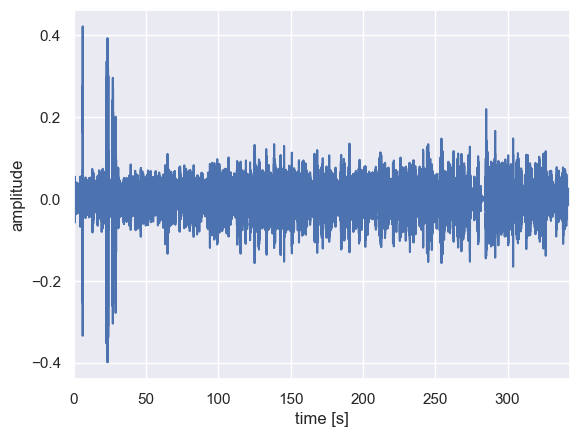

In [5]:
#this creates a object that contain all the required information about parselmouth
snd = parselmouth.Sound("./output_mono.wav")

###############################
#     your code goes here     #
###############################
#using the data extracted by parselmouth(the snd object) you should be able to plot the raw waveform 
# check out their documentation on how to do it, https://parselmouth.readthedocs.io/en/stable/examples/plotting.html

plt.figure()
plt.plot(snd.xs(), snd.values.T)
plt.xlim([snd.xmin, snd.xmax])
plt.xlabel("time [s]")
plt.ylabel("amplitude")
plt.show()


Initially the peaks you notice are just a distortions(My friend was just adjusting the phone camera and light I guess) that were captured while the video was being recorded.

#### Spectrogram
A spectrogram is a visual representation of the spectrum of frequencies of a signal as it varies with time.
#### [Some cool spectrogram visualizations](https://musiclab.chromeexperiments.com/spectrogram-service/?ln=nl_BE)

#### Task 3.2 Plotting the spectogram.


/var/folders/l6/gd3czkzs6xq2yg2rjms7yfj00000gn/T/ipykernel_25439/1696354979.py:9: RuntimeWarning: divide by zero encountered in log10
  sg_db = 10 * np.log10(spectrogram.values)


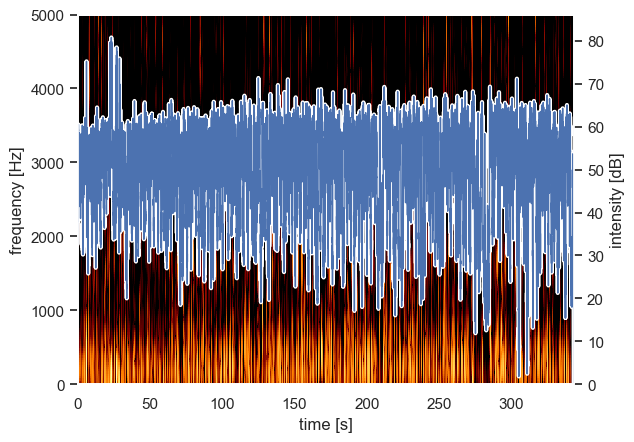

In [6]:
###############################
#     your code goes here     #
###############################
#Again you can consulte the documentation https://parselmouth.readthedocs.io/en/stable/examples/plotting.html
#Plot the spectogram

def draw_spectrogram(spectrogram, dynamic_range=70):
    X, Y = spectrogram.x_grid(), spectrogram.y_grid()
    sg_db = 10 * np.log10(spectrogram.values)
    plt.pcolormesh(X, Y, sg_db, vmin=sg_db.max() - dynamic_range, cmap='afmhot')
    plt.ylim([spectrogram.ymin, spectrogram.ymax])
    plt.xlabel("time [s]")
    plt.ylabel("frequency [Hz]")

def draw_intensity(intensity):
    plt.plot(intensity.xs(), intensity.values.T, linewidth=3, color='w')
    plt.plot(intensity.xs(), intensity.values.T, linewidth=1)
    plt.grid(False)
    plt.ylim(0)
    plt.ylabel("intensity [dB]")

intensity = snd.to_intensity()
spectrogram = snd.to_spectrogram()
plt.figure()
draw_spectrogram(spectrogram)
plt.twinx()
draw_intensity(intensity)
plt.xlim([snd.xmin, snd.xmax])
plt.show()

#### Task 3.3: Look at the waveform and spectorgram, can you associate it with the audio(i.e find words/pauses that match the wave).

Your observations: 

The intensity is usually in 40-65 dB range, that is the voice level for normal converation in office like envirenmont.

from the above visual, whenever the intensity drops below 20dB I took pause and thought for a moment what I was going to say next. 

At around 305 second mark I was taking about my family and was taking the significantly long pauses; so that adds up to what the spectograph says.

Also at 285 seconds mark there was pin drop scielnce for a moment,quiter than 305 mark but it still shows lower intensity at the end.

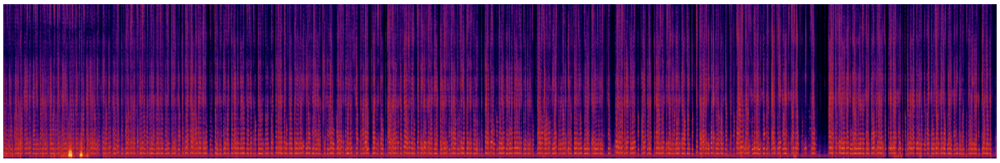

In [7]:
from IPython.display import Image
Image("/Users/bhautik/Desktop/spectograph_fromWeb.png")

## I created this below spectograph from this website   https://convert.ing-now.com   and 

In [8]:
#path of your audio files
Audio("./output_mono.wav",rate=samplerate)

#### Task 3.4 Below you will find function to play around with your pitch, after which you should report your observations.(e.g. your perception to the changes in pitch) 

In [13]:
#Again function courtesy of https://parselmouth.readthedocs.io/en/stable/examples/pitch_manipulation.html

#Change the pitch
def change_pitch(sound, factor):
    manipulation = call(sound, "To Manipulation", 0.01, 75, 600)
    pitch_tier = call(manipulation, "Extract pitch tier")
    call(pitch_tier, "Multiply frequencies", sound.xmin, sound.xmax, factor)
    call([pitch_tier, manipulation], "Replace pitch tier")
    return call(manipulation, "Get resynthesis (overlap-add)")

#Update pitch and play sound
def interactive_change_pitch(factor):
    sound_changed_pitch = change_pitch(snd, factor)
    display(Audio(data=sound_changed_pitch.values, rate=sound_changed_pitch.sampling_frequency))

#Slider for the pitch factor
pitch_slider = widgets.FloatSlider(min=0.25, max=4, step=0.05, value=1.5, description="Pitch Factor")

#Interactive display
output = widgets.Output()

def update_audio(change):
    output.clear_output(wait=True)  # Update the audio when the slider value changes
    with output:
        interactive_change_pitch(pitch_slider.value)

#Observer to the slider
pitch_slider.observe(update_audio, names="value")

#Slider and output
display(pitch_slider, output)

#The initial audio display
with output:
    interactive_change_pitch(pitch_slider.value)

FloatSlider(value=1.5, description='Pitch Factor', max=4.0, min=0.25, step=0.05)

Output()

Your Observations: 

(1) When I increase pitch factor(>1) my voice sounds higher, like a younger version of myself and more feminine.
When I set it to very high(2.5 or more) it makes my voice sound chipmunk-like and unnatural.

(2) When I decrease the pitch factor my voice sounds deeper, resembling an older or more "masculine" version of me.
A very low factor (e.g., 0.5 or less) makes my voice sound unnatural, distorted and robotic.


----

### Feature Extraction
Here we are using the predefined feature set ComParE_2016. We use Opensmile for the feature extraction process.   

In the following cells we will be concentrating on the few important features related to the Speech. These include Intensity, Fundamental Frequency , Shimmer and Jitter. The Tasks for this sheet would be calculating and analysing the statistical features associated with the features mentioned previously.

Below you see all the features that can be extracted from opensmile and also the highlighted features are the ones we will be looking closely in this notebook

  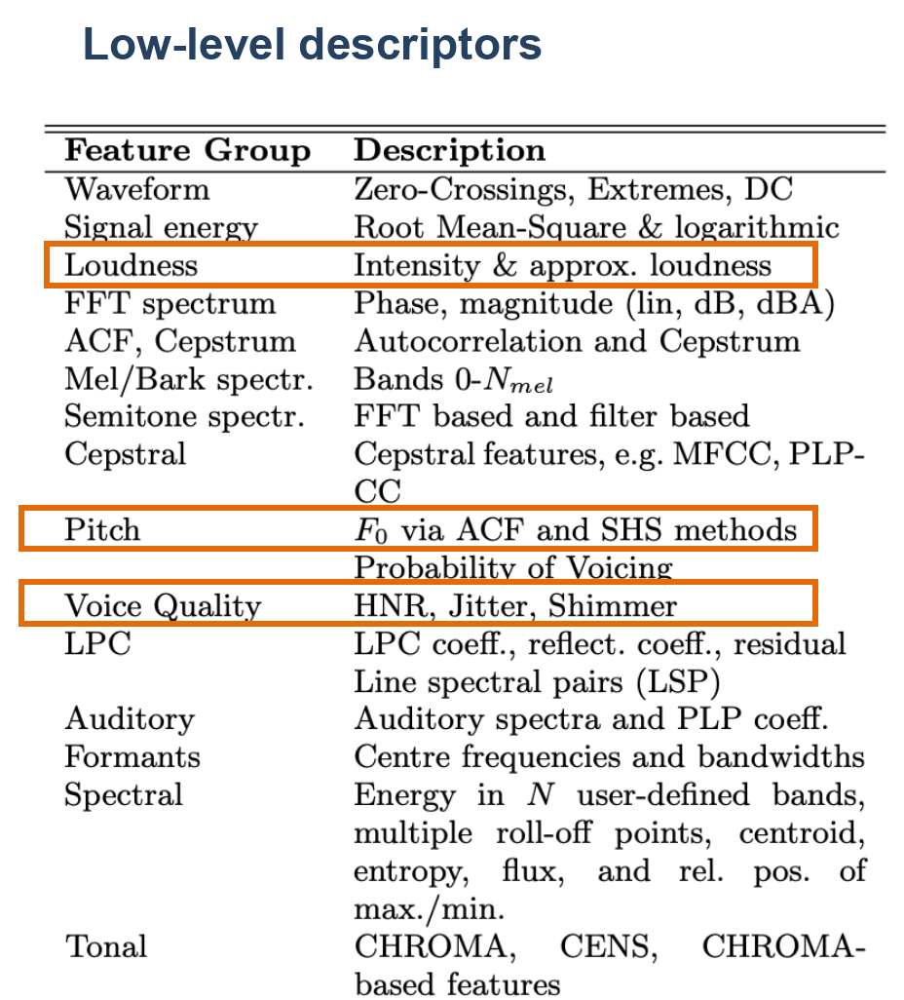
    
   
Before we look at the different features, lets see how to extract them using OpenSMile. The below cell provides the code to extract a feature set from a speech signal.

In [14]:
#configuration for what are the features that are extracted by opensmile. 
smile_ComParE_2016_lld = opensmile.Smile(
    feature_set=opensmile.FeatureSet.ComParE_2016,
    feature_level=opensmile.FeatureLevel.LowLevelDescriptors,
)

#change the path to your file 
features_extracted_lld = smile_ComParE_2016_lld.process_file('./output_mono.wav')

#configuration for what are the features that are extracted by opensmile. 
smile_ComParE_2016_functionals = opensmile.Smile(
    feature_set=opensmile.FeatureSet.ComParE_2016,
    feature_level=opensmile.FeatureLevel.Functionals,
)
#change the path to your file 
features_extracted_functionals = smile_ComParE_2016_functionals.process_file('./output_mono.wav')

In [15]:
#list of all the low level descriptor feature names
smile_ComParE_2016_lld.feature_names

['F0final_sma',
 'voicingFinalUnclipped_sma',
 'jitterLocal_sma',
 'jitterDDP_sma',
 'shimmerLocal_sma',
 'logHNR_sma',
 'audspec_lengthL1norm_sma',
 'audspecRasta_lengthL1norm_sma',
 'pcm_RMSenergy_sma',
 'pcm_zcr_sma',
 'audSpec_Rfilt_sma[0]',
 'audSpec_Rfilt_sma[1]',
 'audSpec_Rfilt_sma[2]',
 'audSpec_Rfilt_sma[3]',
 'audSpec_Rfilt_sma[4]',
 'audSpec_Rfilt_sma[5]',
 'audSpec_Rfilt_sma[6]',
 'audSpec_Rfilt_sma[7]',
 'audSpec_Rfilt_sma[8]',
 'audSpec_Rfilt_sma[9]',
 'audSpec_Rfilt_sma[10]',
 'audSpec_Rfilt_sma[11]',
 'audSpec_Rfilt_sma[12]',
 'audSpec_Rfilt_sma[13]',
 'audSpec_Rfilt_sma[14]',
 'audSpec_Rfilt_sma[15]',
 'audSpec_Rfilt_sma[16]',
 'audSpec_Rfilt_sma[17]',
 'audSpec_Rfilt_sma[18]',
 'audSpec_Rfilt_sma[19]',
 'audSpec_Rfilt_sma[20]',
 'audSpec_Rfilt_sma[21]',
 'audSpec_Rfilt_sma[22]',
 'audSpec_Rfilt_sma[23]',
 'audSpec_Rfilt_sma[24]',
 'audSpec_Rfilt_sma[25]',
 'pcm_fftMag_fband250-650_sma',
 'pcm_fftMag_fband1000-4000_sma',
 'pcm_fftMag_spectralRollOff25.0_sma',
 'pcm_ff

In [16]:
#list of all the functional feature names
smile_ComParE_2016_functionals.feature_names

['audspec_lengthL1norm_sma_range',
 'audspec_lengthL1norm_sma_maxPos',
 'audspec_lengthL1norm_sma_minPos',
 'audspec_lengthL1norm_sma_quartile1',
 'audspec_lengthL1norm_sma_quartile2',
 'audspec_lengthL1norm_sma_quartile3',
 'audspec_lengthL1norm_sma_iqr1-2',
 'audspec_lengthL1norm_sma_iqr2-3',
 'audspec_lengthL1norm_sma_iqr1-3',
 'audspec_lengthL1norm_sma_percentile1.0',
 'audspec_lengthL1norm_sma_percentile99.0',
 'audspec_lengthL1norm_sma_pctlrange0-1',
 'audspec_lengthL1norm_sma_stddev',
 'audspec_lengthL1norm_sma_skewness',
 'audspec_lengthL1norm_sma_kurtosis',
 'audspec_lengthL1norm_sma_meanSegLen',
 'audspec_lengthL1norm_sma_maxSegLen',
 'audspec_lengthL1norm_sma_minSegLen',
 'audspec_lengthL1norm_sma_segLenStddev',
 'audspec_lengthL1norm_sma_upleveltime25',
 'audspec_lengthL1norm_sma_upleveltime50',
 'audspec_lengthL1norm_sma_upleveltime75',
 'audspec_lengthL1norm_sma_upleveltime90',
 'audspec_lengthL1norm_sma_risetime',
 'audspec_lengthL1norm_sma_leftctime',
 'audspec_lengthL1

In [17]:
#dataframe of the low level features extracted
features_extracted_lld

F0final_sma  \
file              start                  end                                      
./output_mono.wav 0 days 00:00:00        0 days 00:00:00.060000             0.0   
                  0 days 00:00:00.010000 0 days 00:00:00.070000             0.0   
                  0 days 00:00:00.020000 0 days 00:00:00.080000             0.0   
                  0 days 00:00:00.030000 0 days 00:00:00.090000             0.0   
                  0 days 00:00:00.040000 0 days 00:00:00.100000             0.0   
...                                                                         ...   
                  0 days 00:05:43.120000 0 days 00:05:43.180000             0.0   
                  0 days 00:05:43.130000 0 days 00:05:43.190000             0.0   
                  0 days 00:05:43.140000 0 days 00:05:43.200000             0.0   
                  0 days 00:05:43.150000 0 days 00:05:43.210000             0.0   
                                         0 days 00:05:43.212687500          0.0   

                                                                    voicingFinalUnclipped_sma  \
file              start                  end                                                    
./output_mono.wav 0 days 00:00:00        0 days 00:00:00.060000                      0.000000   
                  0 days 00:00:00.010000 0 days 00:00:00.070000                      0.000000   
                  0 days 00:00:00.020000 0 days 00:00:00.080000                      0.000000   
                  0 days 00:00:00.030000 0 days 00:00:00.090000                      0.651420   
                  0 days 00:00:00.040000 0 days 00:00:00.100000                      0.667713   
...                                                                                       ...   
                  0 days 00:05:43.120000 0 days 00:05:43.180000                      0.000000   
                  0 days 00:05:43.130000 0 days 00:05:43.190000                      0.000000   
                  0 days 00:05:43.140000 0 days 00:05:43.200000                      0.000000   
                  0 days 00:05:43.150000 0 days 00:05:43.210000                      0.000000   
                                         0 days 00:05:43.212687500                   0.000000   

                                                                    jitterLocal_sma  \
file              start                  end                                          
./output_mono.wav 0 days 00:00:00        0 days 00:00:00.060000                 0.0   
                  0 days 00:00:00.010000 0 days 00:00:00.070000                 0.0   
                  0 days 00:00:00.020000 0 days 00:00:00.080000                 0.0   
                  0 days 00:00:00.030000 0 days 00:00:00.090000                 0.0   
                  0 days 00:00:00.040000 0 days 00:00:00.100000                 0.0   
...                                                                             ...   
                  0 days 00:05:43.120000 0 days 00:05:43.180000                 0.0   
                  0 days 00:05:43.130000 0 days 00:05:43.190000                 0.0   
                  0 days 00:05:43.140000 0 days 00:05:43.200000                 0.0   
                  0 days 00:05:43.150000 0 days 00:05:43.210000                 0.0   
                                         0 days 00:05:43.212687500              0.0   

                                                                    jitterDDP_sma  \
file              start                  end                                        
./output_mono.wav 0 days 00:00:00        0 days 00:00:00.060000               0.0   
                  0 days 00:00:00.010000 0 days 00:00:00.070000               0.0   
                  0 days 00:00:00.020000 0 days 00:00:00.080000               0.0   
                  0 days 00:00:00.030000 0 days 00:00:00.090000               0.0   
                  0 days 00:00:00.040000 0 days 00:00:00.100000               0.0   

In [18]:
#dataframe of the functional features extracted 
features_extracted_functionals

,,,audspec_lengthL1norm_sma_range,audspec_lengthL1norm_sma_maxPos,audspec_lengthL1norm_sma_minPos,audspec_lengthL1norm_sma_quartile1,audspec_lengthL1norm_sma_quartile2,audspec_lengthL1norm_sma_quartile3,audspec_lengthL1norm_sma_iqr1-2,audspec_lengthL1norm_sma_iqr2-3,audspec_lengthL1norm_sma_iqr1-3,audspec_lengthL1norm_sma_percentile1.0,...,mfcc_sma_de[14]_peakRangeAbs,mfcc_sma_de[14]_peakRangeRel,mfcc_sma_de[14]_peakMeanAbs,mfcc_sma_de[14]_peakMeanMeanDist,mfcc_sma_de[14]_peakMeanRel,mfcc_sma_de[14]_minRangeRel,mfcc_sma_de[14]_meanRisingSlope,mfcc_sma_de[14]_stddevRisingSlope,mfcc_sma_de[14]_meanFallingSlope,mfcc_sma_de[14]_stddevFallingSlope
file,start,end,,,,,,,,,,,,,,,,,,,,,
./output_mono.wav,0 days,0 days 00:05:43.212687500,1.117601,0.831293,0.889462,0.073843,0.176234,0.273187,0.102391,0.096953,0.199344,0.013767,...,9.1709,0.561286,2.247458,2.247102,20.0,0.602956,101.977524,49.942635,101.296196,50.451496


#### Loudness 
The amplitude of the vibrations (i.e. the size of the oscillations of the vocal folds) that affects loudness: The greater the amplitude of the vibrations, the greater the amount of energy carried by the wave, and the more intense the sound will be.
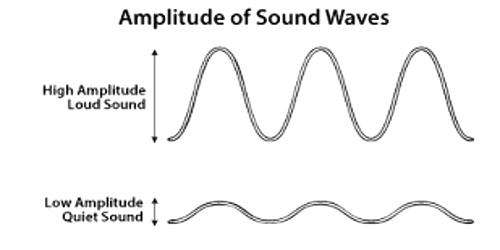
[source](https://www.sltinfo.com/loudness/)
    

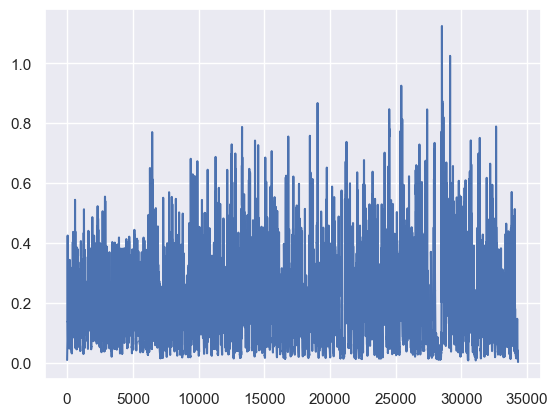

In [19]:
#plot for the Intensity
plt.plot(features_extracted_lld["audspec_lengthL1norm_sma"].values)

#### Task 3.5  Analysis of Loudness: Calculate the mean, median, range, standard deviation and plot the histogram. In the below cell write about your observations. (within your observation try to incorporate relevant aspects about these features that you have been introduced to in the lecture) 

Loudness Statistics:
count    34317.000000
mean         0.192684
std          0.138424
min          0.001689
25%          0.073785
50%          0.176230
75%          0.273172
max          1.124606
dtype: float64


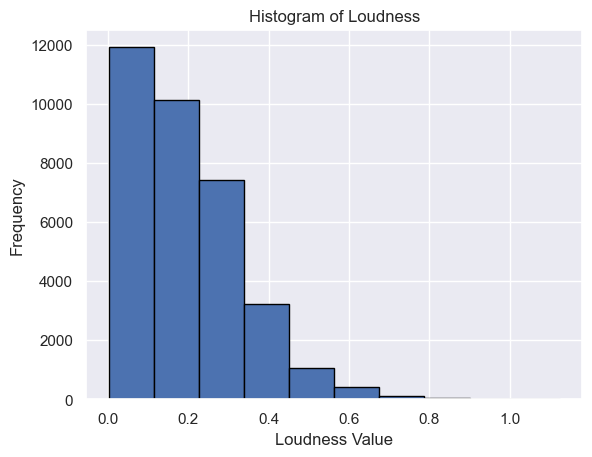

In [20]:
###############################
#     your code goes here     #
###############################
# Calculate the mean, median, range, standard deviation and plot the histograms of loudness
loudness_feature = features_extracted_lld["audspec_lengthL1norm_sma"].values
loudness_feature_series = pd.Series(loudness_feature)   #array to pandas series
loudness_stats = loudness_feature_series.describe()
print("Loudness Statistics:")
print(loudness_stats)


#Histogram
plt.hist(loudness_feature, bins=10, edgecolor='black')
plt.title('Histogram of Loudness')
plt.xlabel('Loudness Value')
plt.ylabel('Frequency')
plt.show()



*Your interesting findings* :  

The histogram here shows a heavily skewed distribution, with most loud values between 0.0 and 0.3, indicating predominantly soft audio that also checks with my actual voice. The peak occurs at the lowest range (0.0–0.2), with frequencies declining sharply as loudness increases. Values above 0.6 are rare, meaning I did not use louder voice. Overall, Overall I can say it features a quiet or calm environment with minimal dynamic variation that also checks with what happened really, We shot the video on 2nd floor of CITEC directly above 1.015


#### Fundamental Frequency ($F_0 $)
The  fundamental  frequency,  measured  in  Hertz,  is  defined  as  the  number  of  times  a  sound  wave  produced  by  the  vocal  cords repeats during a given time period. It has a typical range of values it can take depending on the gender and age of the person. 
    
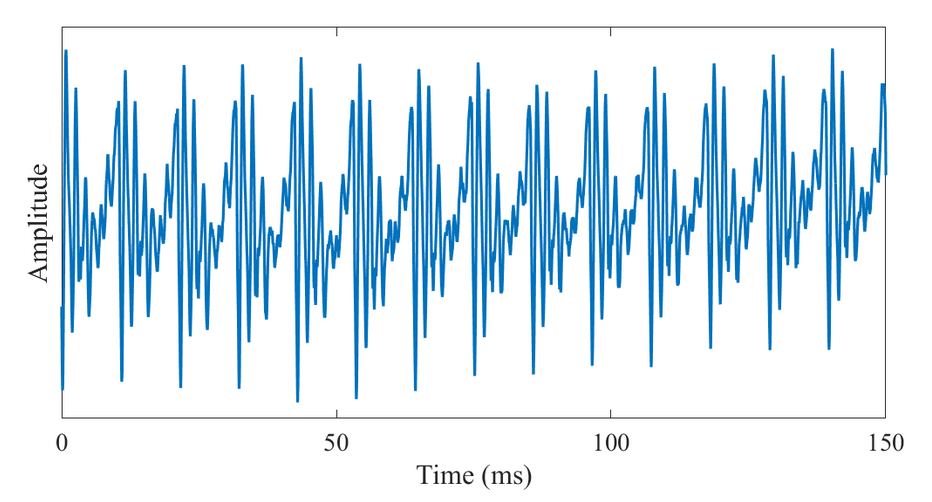
A speech signal with a fundamental frequency of approximately F0=93Hz.[source](https://wiki.aalto.fi/pages/viewpage.action?pageId=149890776)



#### *Plot of the fundamental frequency over time:*

Text(0, 0.5, 'Frequency')

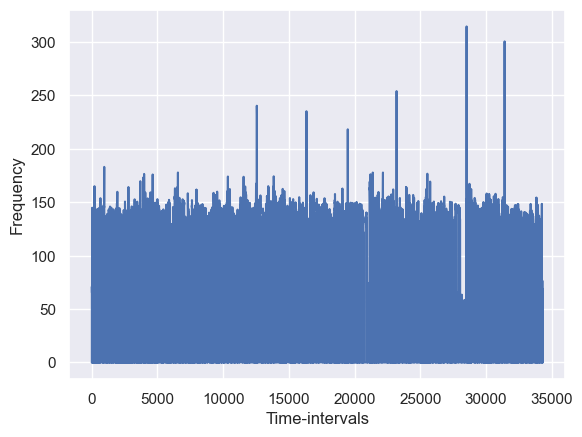

In [21]:
#plot for the fundamental frequency 
plt.plot(features_extracted_lld["F0final_sma"].values)
#each time interval is 1ms
plt.xlabel('Time-intervals')
plt.ylabel('Frequency')

#### Task 3.6 Analysis of Fundamental Frequency:Calculate the mean, median, range, standard deviation and plot the histogram. In the below cell write about your observations.(within your observation try to incorporate relevant aspects about these features that you have been introduced to in the lecture) 

Fundamental Frequency Statistics:
count    34317.000000
mean        76.556580
std         68.517174
min          0.000000
25%          0.000000
50%        126.922432
75%        138.740631
max        314.638062
dtype: float64


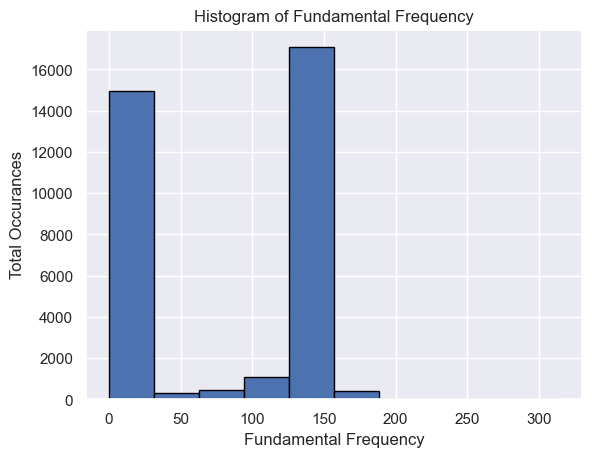

In [22]:
###############################
#     your code goes here     #
###############################
# Calculate the mean, median, range, standard deviation and plot the histograms of fundamental frequency


ff_feature = features_extracted_lld["F0final_sma"].values
ff_series = pd.Series(ff_feature)   #array to pandas series
ff_stats = ff_series.describe()
print("Fundamental Frequency Statistics:")
print(ff_stats)


#Histogram
plt.hist(ff_feature, bins=10, edgecolor='black')
plt.title('Histogram of Fundamental Frequency')
plt.xlabel('Fundamental Frequency')
plt.ylabel('Total Occurances')
plt.show()



*Your interesting findings* :

Nothing interesting, The second peak, ~125 Hz, represents my average speaking pitch, as male fundamental frequencies generally range between 85–155 Hz; this is common. The first peak at 0 Hz corresponds to silence.
The mean frequency of 76.56 Hz and standard deviation of 68.52 Hz suggest variability, possibly due to intonation or non-speech sounds. The low to no presence of frequencies above 150 Hz further confirms the expected range for a male voice my age.

#### Jitter and Shimmer
Measurements  of  F0  disturbance has  proven  to  be  useful  in  describing  the  vocal  characteristics. The two important disturbances are Jitter and Shimmer. Jitter  is  defined  as  the  parameter  of  frequency  variation  from  cycle  to  cycle,  and  shimmer  relates  to  the  amplitude  variation  of  the  sound  wave. 

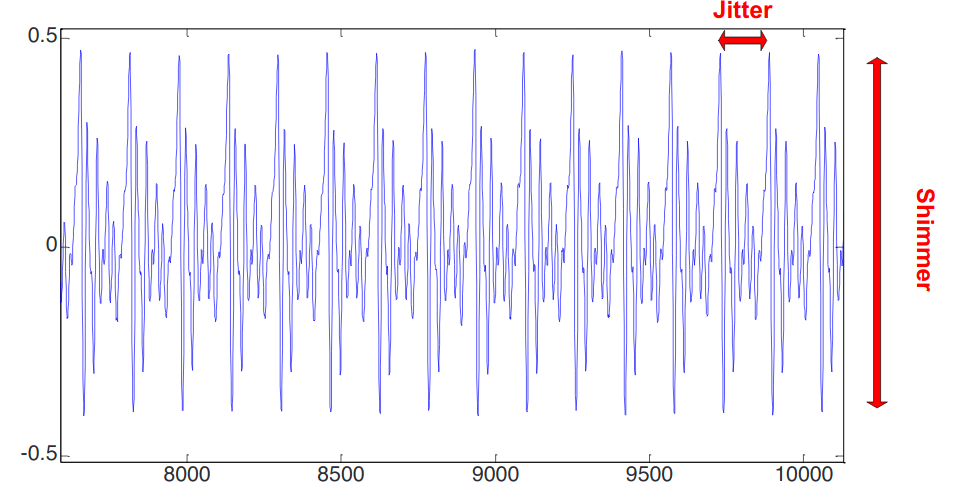 [source](https://www.sciencedirect.com/science/article/pii/S2212017313002788)

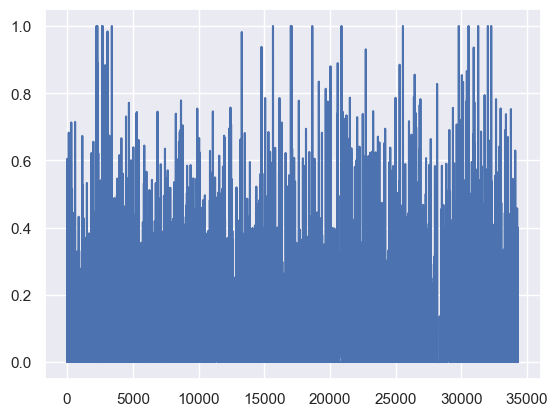

In [23]:
#plot for shimmer
plt.plot(features_extracted_lld["shimmerLocal_sma"].values)

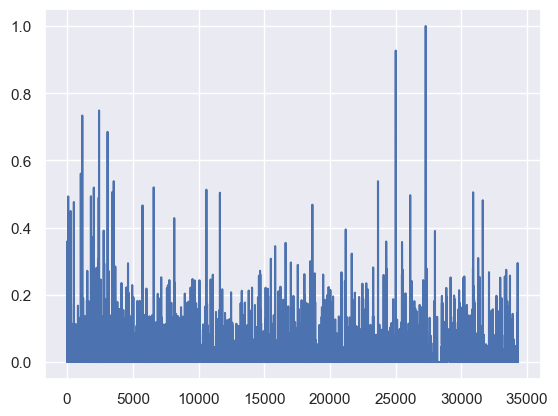

In [24]:
#plot for jitter
plt.plot(features_extracted_lld["jitterLocal_sma"].values)    

#### Task 3.7 and 3.8 Analysis of Jitter and Shimmer:Calculate the mean, median, range, standard deviation and plot the histogram. In the below cell write about your observations.(within your observation try to incorporate relevant aspects about these features that you have been introduced to in the lecture) 

Shimmer Statistics:
count    34317.000000
mean         0.086855
std          0.122857
min          0.000000
25%          0.000000
50%          0.047295
75%          0.130558
max          1.000000
dtype: float64


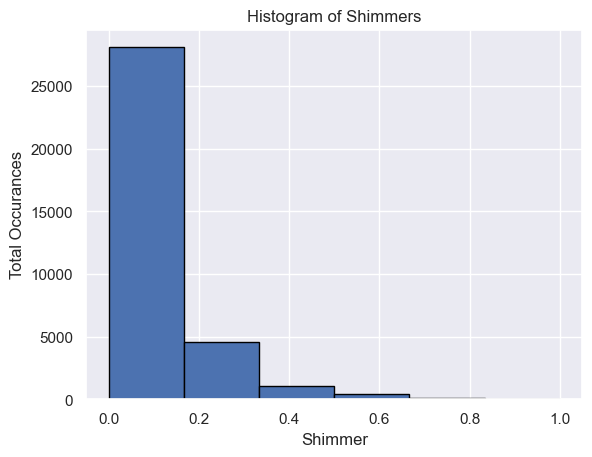

In [26]:
###############################
#     your code goes here     #
###############################
# Calculate the mean, median, range, standard deviation and plot the histograms of shimmer

sm_feature = features_extracted_lld["shimmerLocal_sma"].values
sm_series = pd.Series(sm_feature)   #array to pandas series
sm_stats = sm_series.describe()
print("Shimmer Statistics:")
print(sm_stats)


#Histogram
plt.hist(sm_feature, bins=6, edgecolor='black')
plt.title('Histogram of Shimmers')
plt.xlabel('Shimmer')
plt.ylabel('Total Occurances')
plt.show()

The histogram shows that most shimmer values are near 0, indicating stable voice amplitude(average shimmer is on the order of 0.1 dB) with minimal variation. The average shimmer (0.086) is typical for a healthy voice. Higher shimmer values are rare, suggesting occasional instability or louder speech. This distribution confirms normal vocal fold function and stability.

Jitter Statistics:
count    34317.000000
mean         0.013980
std          0.037005
min          0.000000
25%          0.000000
50%          0.002340
75%          0.012777
max          1.000000
dtype: float64


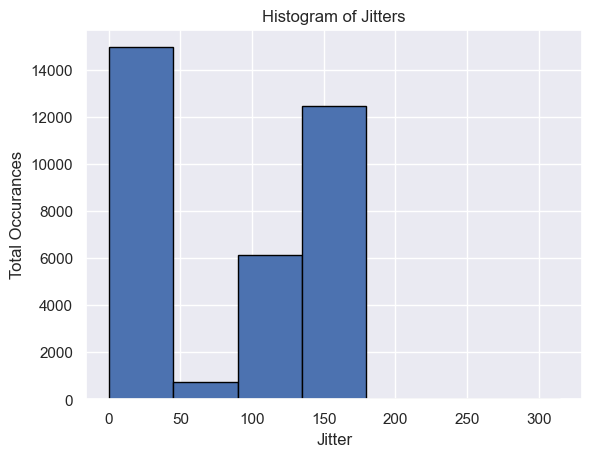

In [29]:
###############################
#     your code goes here     #
###############################
# Calculate the mean, median, range, standard deviation and plot the histograms of Jitter 

jt_feature = features_extracted_lld["jitterLocal_sma"].values
jt_series = pd.Series(jt_feature)   #array to pandas series
jt_stats = jt_series.describe()
print("Jitter Statistics:")
print(jt_stats)


#Histogram
plt.hist(ff_feature, bins=7, edgecolor='black')
plt.title('Histogram of Jitters')
plt.xlabel('Jitter')
plt.ylabel('Total Occurances')
plt.show()

The histogram shows that most jitter values are concentrated near 0, indicating stable frequency variations, typical of a healthy voice. The mean jitter (0.0139) reflects minimal pitch variation, with occasional higher values corresponding to minor frequency instabilities.

#### Task 3.9: Plot mfcc coeffiecients

Here is an example of possible solution:
![example of possible solution](voice.png)

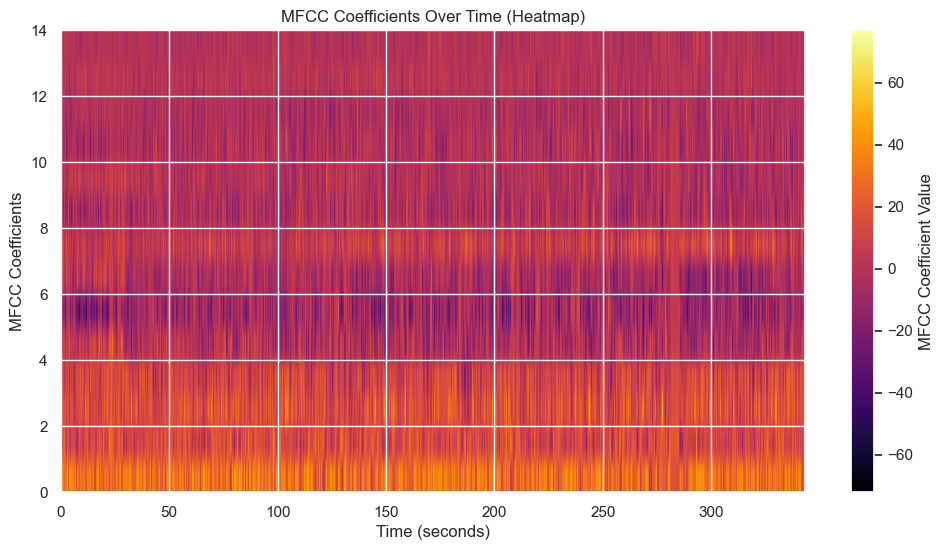

In [37]:
###############################
#     your code goes here     #
###############################
# get all the mfcc co-efficients from the extracted features dataframe and plot them as shown below
# You first need to filter the dataframe to get the mfcc coeffiecient


#Reset the MultiIndex to flatten it into columns
mfcc_data = features_extracted_lld.reset_index()


x_axis = pd.to_timedelta(mfcc_data['start']).dt.total_seconds()      #the `start` time for the x-axis

#MFCC columns for plotting
mfcc_columns = [col for col in mfcc_data.columns if col.startswith('mfcc_sma')]
mfcc_values = mfcc_data[mfcc_columns].to_numpy()

#Heatmap
plt.figure(figsize=(12, 6))
plt.imshow(
    mfcc_values.T,  #Transpose so time is on the x-axis, and coefficients are on the y-axis
    aspect='auto', 
    origin='lower',  
    cmap='inferno',  
    extent=[x_axis.min(), x_axis.max(), 0, mfcc_values.shape[1]]  
)

plt.colorbar(label='MFCC Coefficient Value')
plt.xlabel('Time (seconds)')
plt.ylabel('MFCC Coefficients')
plt.title('MFCC Coefficients Over Time (Heatmap)')
plt.show()